In [17]:
# === Core Libraries ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# === Machine Learning & Preprocessing ===
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.linear_model import Lasso

# === Parallel Processing ===
from joblib import Parallel, delayed
from tqdm import tqdm

# === Neuroimaging Tools ===
import abagen
import nibabel as nib
from mpl_toolkits.mplot3d import Axes3D  # for 3D plotting (if needed)

import os

def fix_abagen_inplace_bug(file_path):
    with open(file_path, 'r') as f:
        lines = f.readlines()

    modified = False
    new_lines = []
    for line in lines:
        if 'set_axis' in line and 'inplace=False' in line:
            # Remove 'inplace=False' safely
            line = line.replace(', inplace=False', '').replace('inplace=False, ', '').replace('inplace=False', '')
            modified = True
        new_lines.append(line)

    if modified:
        backup_path = file_path + '.bak'
        os.rename(file_path, backup_path)  # backup original
        with open(file_path, 'w') as f:
            f.writelines(new_lines)
        print(f"✅ Patched and saved. Backup created at: {backup_path}")
    else:
        print("⚠️ No matching line with 'inplace=False' found. No changes made.")

# Example: Update this path to the actual probes_.py file path
fix_abagen_inplace_bug('/opt/anaconda3/lib/python3.12/site-packages/abagen/probes_.py')



In [18]:


def fit_lasso_row(i, X, alpha):
    x_i = X[i]
    X_others = np.delete(X, i, axis=0)

    model = Lasso(alpha=alpha, fit_intercept=False, max_iter=10000)
    model.fit(X_others.T, x_i)

    coefs = model.coef_
    row = np.zeros(X.shape[0])
    row[:i] = coefs[:i]
    row[i+1:] = coefs[i:]
    return row

def lasso_similarity_graph_parallel(X, alpha=0.001, n_jobs=-1):
    """
    Parallel LASSO-based similarity graph.
    X: (n_regions, n_features)
    alpha: L1 regularization
    n_jobs: number of CPU cores to use (-1 = all)
    Returns: A (n_regions, n_regions)
    """
    results = Parallel(n_jobs=n_jobs)(
        delayed(fit_lasso_row)(i, X, alpha) for i in tqdm(range(X.shape[0]), desc="Parallel LASSO")
    )
    A = np.vstack(results)
    return A

def sparse_simplex_paper_style(X, step_size=1e-2, max_iter=100, tol=1e-6, n_jobs=8):
    """
    Sparse Simplex graph learning using the exact formulation from the original paper,
    with projection via root-finding method (Newton) implemented inside for joblib compatibility.
    
    Parameters:
    - X: (n_regions, n_genes) standardized gene expression matrix
    - step_size: step size for projected gradient descent
    - max_iter: maximum gradient iterations
    - tol: convergence tolerance
    - n_jobs: number of parallel jobs
    
    Returns:
    - A: (n_regions, n_regions) sparse similarity matrix
    """


    def solve_sparse_simplex(v, max_iter=100, tol=1e-6):
        """
        Solves: min 1/2 ||alpha - v||^2 s.t. alpha >= 0, sum(alpha) = 1
        via Newton's method on the dual variable as per the Sparse Simplex paper.
        """
        def f(lmbd_bar):
            return np.sum(np.maximum(v - lmbd_bar, 0)) - 1

        def f_prime(lmbd_bar):
            return -np.sum((v - lmbd_bar) > 0)

        lmbd_bar = np.max(v) - 1e-3
        for _ in range(max_iter):
            f_val = f(lmbd_bar)
            if abs(f_val) < tol:
                break
            lmbd_bar -= f_val / f_prime(lmbd_bar)

        return np.maximum(v - lmbd_bar, 0)

    n = X.shape[0]

    def optimize_alpha(i):
        xi = X[i]
        X_others = np.delete(X, i, axis=0)
        alpha_i = np.ones(n - 1) / (n - 1)

        for _ in range(max_iter):
            grad = X_others @ (X_others.T @ alpha_i - xi)
            new_alpha = solve_sparse_simplex(alpha_i - step_size * grad)
            if np.linalg.norm(new_alpha - alpha_i) < tol:
                break
            alpha_i = new_alpha

        row = np.zeros(n)
        row[:i] = alpha_i[:i]
        row[i+1:] = alpha_i[i:]
        return row

    A = Parallel(n_jobs=n_jobs)(
        delayed(optimize_alpha)(i) for i in tqdm(range(n), desc="Sparse Simplex (original)")
    )

    return np.vstack(A)


In [19]:

def plot_node_connections(A, coords, node_index, threshold=0.01, cmap='Viridis'):
    """
    Plot 3D graph of a brain region's connections based on LASSO weights.
    
    Parameters:
    - A: similarity matrix (n x n)
    - coords: array of shape (n, 3) with brain region 3D coordinates
    - node_index: index of the node to plot connections from
    - threshold: minimum weight to include an edge
    - cmap: Plotly colormap name
    """
    coords = np.array(coords)
    N = A.shape[0]
    x_nodes, y_nodes, z_nodes = coords[:, 0], coords[:, 1], coords[:, 2]

    segments = []
    strengths = []

    for j in range(N):
        weight = A[node_index, j]
        if j != node_index and weight > threshold:
            x0, y0, z0 = coords[node_index]
            x1, y1, z1 = coords[j]
            segments.append(((x0, x1), (y0, y1), (z0, z1)))
            strengths.append(weight)

    strengths = np.array(strengths)
    norm_strengths = (strengths - strengths.min()) / (strengths.max() - strengths.min() + 1e-8)

    # One trace to show the colorbar legend using dummy line
    colorbar_trace = go.Scatter3d(
        x=[None], y=[None], z=[None],
        mode='lines',
        line=dict(color=[0, 1], colorscale=cmap, cmin=0, cmax=1, width=4),
        showlegend=True,
        name='Edge Strength',
        hoverinfo='none'
    )

    edge_traces = []
    for seg, strength in zip(segments, norm_strengths):
        edge_traces.append(go.Scatter3d(
            x=[seg[0][0], seg[0][1]],
            y=[seg[1][0], seg[1][1]],
            z=[seg[2][0], seg[2][1]],
            mode='lines',
            line=dict(color=strength, colorscale=cmap, cmin=0, cmax=1, width=4),
            hoverinfo='skip',
            showlegend=False
        ))

    node_trace = go.Scatter3d(
        x=x_nodes, y=y_nodes, z=z_nodes,
        mode='markers',
        marker=dict(size=4, color='lightgray'),
        name='Brain Regions'
    )

    source_trace = go.Scatter3d(
        x=[coords[node_index][0]],
        y=[coords[node_index][1]],
        z=[coords[node_index][2]],
        mode='markers',
        marker=dict(size=7, color='red'),
        name=f'Source Node {node_index}'
    )

    fig = go.Figure(data=[colorbar_trace] + edge_traces + [node_trace, source_trace])
    fig.update_layout(
        title=f"Connections from Brain Region {node_index}",
        scene=dict(
            xaxis_title='X', yaxis_title='Y', zaxis_title='Z',
            aspectmode='data'
        ),
        margin=dict(l=0, r=0, t=40, b=0),
        showlegend=True
    )
    fig.show()


In [39]:


def find_best_connectome_slice(coords, bg_img, tol=2.0):
    """
    Finds the slice index and MNI location with the most node coverage per plane.

    Parameters:
    - coords: (N, 3) MNI coordinates
    - bg_img: nibabel.Nifti1Image
    - tol: tolerance (in mm) to consider a node "within" a slice

    Returns:
    - best_plane: 'x', 'y', or 'z'
    - best_mm: best MNI slice value
    - best_voxel: voxel index along that axis
    - best_count: number of nodes
    - full_stats: dict {plane: (mm, voxel_index, count)}
    """
    coords = np.array(coords)
    affine = bg_img.affine
    shape = bg_img.shape
    results = {}

    for plane, axis in zip(['x', 'y', 'z'], [0, 1, 2]):
        max_count = 0
        best_mm = None
        best_voxel = None

        for voxel_idx in range(shape[axis]):
            # Build voxel coordinate (centered)
            voxel_coord = np.zeros(3)
            voxel_coord[axis] = voxel_idx
            mni = nib.affines.apply_affine(affine, voxel_coord)[axis]

            # Count how many nodes fall within ±tol mm of this MNI coordinate
            count = np.sum(np.abs(coords[:, axis] - mni) <= tol)
            if count > max_count:
                max_count = count
                best_mm = mni
                best_voxel = voxel_idx

        results[plane] = (best_mm, best_voxel, max_count)

    # Choose best across planes
    best_plane = max(results, key=lambda p: results[p][2])
    best_mm, best_voxel, best_count = results[best_plane]

    return best_plane, best_mm, best_voxel, best_count, results

def plot_2d_connectome_slice_with_bg(A, coords, bg_img, plane='z', slice_index=0, threshold=0.01, tol=2.0, figsize=(6, 6), dpi=300, save_path=None):
    """
    Plots a clean 2D connectome slice over a brain background like publication figures.

    Parameters:
    - A: (N, N) adjacency matrix
    - coords: (N, 3) MNI coordinates
    - bg_img: nibabel NIfTI image
    - plane: 'x', 'y', or 'z' slice
    - slice_index: position in mm along selected plane
    - threshold: minimum edge weight
    - tol: mm tolerance around slice_index to include node
    - figsize: matplotlib figure size
    - dpi: output DPI
    - save_path: optional path to save the figure
    """
    assert plane in ['x', 'y', 'z'], "plane must be 'x', 'y', or 'z'"
    axis = {'x': 0, 'y': 1, 'z': 2}[plane]
    other_axes = [i for i in range(3) if i != axis]

    coords = np.array(coords)
    affine = bg_img.affine
    inv_affine = np.linalg.inv(affine)

    # === Convert slice_index (mm) → voxel index ===
    voxel_center = np.round(nib.affines.apply_affine(inv_affine, [[slice_index if i == axis else 0 for i in range(3)]])[0]).astype(int)
    slice_voxel_index = voxel_center[axis]

    # === Get anatomical slice ===
    bg_data = bg_img.get_fdata()
    if plane == 'x':
        slice_img = np.rot90(bg_data[slice_voxel_index, :, :])
    elif plane == 'y':
        slice_img = np.rot90(bg_data[:, slice_voxel_index, :])
    else:
        slice_img = np.rot90(bg_data[:, :, slice_voxel_index])

    # === Get nodes in slice ===
    mask = np.abs(coords[:, axis] - slice_index) <= tol
    coords_2d = coords[mask]
    A_2d = A[mask][:, mask]

    if coords_2d.shape[0] < 2:
        print(f"Too few nodes ({coords_2d.shape[0]}) in slice. Try adjusting `tol`.")
        return

    # === Project MNI to voxel coords and drop one axis ===
    voxel_coords = nib.affines.apply_affine(inv_affine, coords_2d)
    voxel_proj = voxel_coords[:, other_axes]

    # === Fix Y-axis flipping ===
    voxel_proj[:, 1] = slice_img.shape[0] - voxel_proj[:, 1]

    # === Plot ===
    fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
    ax.imshow(slice_img, cmap='bone', origin='lower', alpha=0.8)

    # Draw edges
    N = A_2d.shape[0]
    for i in range(N):
        for j in range(i + 1, N):
            if A_2d[i, j] > threshold:
                x0, y0 = voxel_proj[i]
                x1, y1 = voxel_proj[j]
                ax.plot([x0, x1], [y0, y1], color='black', linewidth=0.3)

    # Draw nodes
    ax.scatter(voxel_proj[:, 0], voxel_proj[:, 1], color='red', s=6)

    ax.axis('off')
    ax.set_title(f"Plane: {plane.upper()} | Slice: {slice_index} mm", fontsize=10)

    if save_path:
        plt.savefig(save_path, bbox_inches='tight')
    plt.show()



In [21]:
def compute_rmse(X, A):
    n = X.shape[0]
    errors = []
    for i in range(n):
        X_others = np.delete(X, i, axis=0)
        weights = np.delete(A[i], i)
        x_hat = np.dot(weights, X_others)
        rmse = np.sqrt(np.mean((X[i] - x_hat) ** 2))
        errors.append(rmse)
    return np.mean(errors), errors

In [22]:

expression, coords = abagen.get_samples_in_mask(
    mask=None,
    donors='9861',
    probe_selection='max_variance' 
)
full_df = pd.concat([coords, expression], axis=1)

In [3]:
#we use 216 components pca on our genetic expressions to keep 90% of the variance

X_scaled = StandardScaler().fit_transform(expression)
pca = PCA(n_components=216)
X_pca = pca.fit_transform(X_scaled)
print(f"Shape of X_pca: {X_pca.shape}")

Shape of X_pca: (904, 216)


In [23]:
A_pca = lasso_similarity_graph_parallel(X_pca, alpha=0.001, n_jobs=16)

Parallel LASSO:   4%|▎         | 32/904 [00:00<00:29, 29.08it/s]/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.805e+00, tolerance: 1.900e+00
  model = cd_fast.enet_coordinate_descent(
/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.996e+00, tolerance: 1.763e+00
  model = cd_fast.enet_coordinate_descent(
/opt/conda/lib/python3.11/site-packages/sklearn/linear_model/_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider incr

In [24]:
mean_rmse, all_rmses = compute_rmse(X_pca, A_pca)
print("PCA Applied")
print("Minimum RMSE:", np.min(all_rmses))
print("Maximum RMSE:", np.max(all_rmses))
print("Average RMSE:", mean_rmse)
print(len(set(tuple(row.tolist()) for row in A_pca)), A_pca.shape[0])

PCA Applied
Minimum RMSE: 0.0028024054602684887
Maximum RMSE: 0.009540476512692454
Average RMSE: 0.0036258515938273456
904 904


In [25]:
best = np.argmin(all_rmses)
worst = np.argmax(all_rmses)

plot_node_connections(A_pca, coords, node_index=best)
plot_node_connections(A_pca, coords, node_index=worst)

In [26]:
A_ssmp = sparse_simplex_paper_style(
    X_scaled,         # or X_std if you're using full gene features
    step_size=0.01,
    max_iter=500,
    tol=1e-6,
    n_jobs=16
)

Sparse Simplex (original): 100%|██████████| 904/904 [09:16<00:00,  1.62it/s]


In [28]:
mean_rmse_std, all_rmses_std = compute_rmse(X_scaled, A_ssmp)
print("Standardized only")
print("Minimum RMSE:", np.min(all_rmses))
print("Maximum RMSE:", np.max(all_rmses))
print("Average RMSE:", mean_rmse)
print(len(set(tuple(row.tolist()) for row in A_ssmp)), A_ssmp.shape[0])

Standardized only
Minimum RMSE: 0.0028024054602684887
Maximum RMSE: 0.009540476512692454
Average RMSE: 0.0036258515938273456
380 904


In [29]:
best = np.argmin(all_rmses_std)
worst = np.argmax(all_rmses_std)

plot_node_connections(A_pca, coords, node_index=best)
plot_node_connections(A_pca, coords, node_index=worst)

In [30]:
donor9861_atlas = abagen.fetch_desikan_killiany(native=True)["image"]['9861']

im = nib.load(donor9861_atlas)
data = im.get_fdata()
data.shape



(185, 180, 192)

In [33]:
plane, mm, voxel, count, stats = find_best_connectome_slice(coords, im)

print(f"Best slice in {plane.upper()} at mm={mm:.2f}, voxel={voxel}, with {count} nodes")

Best slice in X at mm=-2.50, voxel=95, with 75 nodes


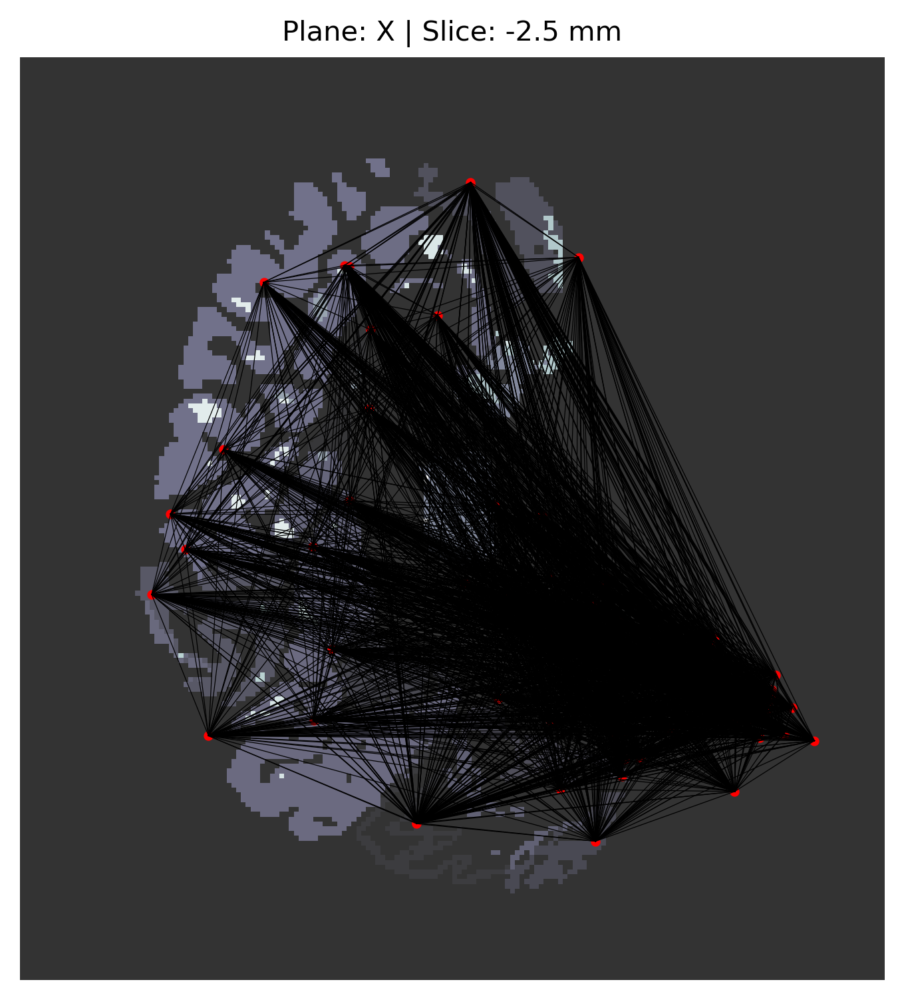

In [65]:
plot_2d_connectome_slice_with_bg(
    A_ssmp,
    coords,
    im,
    plane='x',            # sagittal
    slice_index=-2.5,       # in mm
    threshold=-0.01,
    tol=2.0,
)